In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from statsmodels.tsa.seasonal import STL
import plotly.express as px
import geopandas as gpd

In [2]:
spi1 = pd.read_csv(r"..\data\processed\spi_value_1.csv")
spi3 = pd.read_csv(r"..\data\processed\spi_value_3.csv")
spi12 = pd.read_csv(r"..\data\processed\spi_value_12.csv")

In [3]:
data = pd.read_csv(r"..\data\processed\processed_data.csv")

In [4]:
spi1.head(5)

,Kod stacji,Rok,Miesiąc,Suma dobowa opadów [mm],spi1
0,249210010,1991,1,27.2,-1.096985
1,249210010,1991,2,33.2,-0.870238
2,249210010,1991,3,15.1,-1.700526
3,249210010,1991,4,34.6,-0.821644
4,249210010,1991,5,138.2,1.232069


In [5]:
data.head(5)

,Kod stacji,Nazwa stacji,Rok,Miesiąc,Dzień,Suma dobowa opadów [mm],Wysokość pokrywy śnieżnej [cm],Wysokość świeżospałego śniegu [cm],Wysokość n.p.m.,geometry,Województwo,date,Rodzaj opadu [S/W/ ] _W,Rodzaj opadu [S/W/ ] _brak,Suma dobowa opadów [mm]_boxcox
0,249210010,PILZNO,2001,1,3,12.6,0,0,195,POINT (21.308333333333334 49.98722222222222),podkarpackie,2001-01-03,True,False,3.374984
1,249210010,PILZNO,2001,1,7,1.2,0,0,195,POINT (21.308333333333334 49.98722222222222),podkarpackie,2001-01-07,True,False,0.185968
2,249210010,PILZNO,2001,1,8,15.4,0,0,195,POINT (21.308333333333334 49.98722222222222),podkarpackie,2001-01-08,True,False,3.729900
3,249210010,PILZNO,2001,1,9,8.2,0,0,195,POINT (21.308333333333334 49.98722222222222),podkarpackie,2001-01-09,False,False,2.665130
4,249210010,PILZNO,2001,1,11,1.7,0,0,195,POINT (21.308333333333334 49.98722222222222),podkarpackie,2001-01-11,False,False,0.562302


In [6]:
def classify_spi(spi):
    if spi == np.nan:
        return "No data"
    elif spi >= 2.0:
        return "Ekstremalnie mokro"
    elif 1.5 <= spi < 1.99:
        return "Bardzo mokro"
    elif 1.0 <= spi < 1.49:
        return "Umiarkowanie mokro"
    elif -0.99 <= spi <= 0.99:
        return "Średnie warunki"
    elif -1.49 <= spi <= -1.0:
        return "Umiarkowana susza"
    elif -1.99 <= spi <= -1.5:
        return "Silna susza"
    else:
        return "Ekstremalna susza"

spi1['spi1_Classification'] = spi1['spi1'].apply(classify_spi)
spi3['spi3_Classification'] = spi3['spi3'].apply(classify_spi)
spi12['spi12_Classification'] = spi12['spi12'].apply(classify_spi)

In [7]:
joined_data = spi1.join(data[['geometry', 'Nazwa stacji', 'Kod stacji']].set_index('Kod stacji'), on='Kod stacji').drop_duplicates()
joined_data.head(5)

,Kod stacji,Rok,Miesiąc,Suma dobowa opadów [mm],spi1,spi1_Classification,geometry,Nazwa stacji
0,249210010,1991,1,27.2,-1.096985,Umiarkowana susza,POINT (21.308333333333334 49.98722222222222),PILZNO
1,249210010,1991,2,33.2,-0.870238,Średnie warunki,POINT (21.308333333333334 49.98722222222222),PILZNO
2,249210010,1991,3,15.1,-1.700526,Silna susza,POINT (21.308333333333334 49.98722222222222),PILZNO
3,249210010,1991,4,34.6,-0.821644,Średnie warunki,POINT (21.308333333333334 49.98722222222222),PILZNO
4,249210010,1991,5,138.2,1.232069,Umiarkowanie mokro,POINT (21.308333333333334 49.98722222222222),PILZNO


In [8]:
joined_data.set_index(['Kod stacji', 'Rok', 'Miesiąc'], inplace=True)
spi3.set_index(['Kod stacji', 'Rok', 'Miesiąc'], inplace=True)
spi12.set_index(['Kod stacji', 'Rok', 'Miesiąc'], inplace=True)

joined_data = joined_data.join(spi3[['spi3', 'spi3_Classification']], on = ['Kod stacji', 'Rok', 'Miesiąc']).join(spi12[['spi12', 'spi12_Classification']], on = ['Kod stacji', 'Rok', 'Miesiąc'])
joined_data.head(5)

Suma dobowa opadów [mm]      spi1   
Kod stacji Rok  Miesiąc                                      
249210010  1991 1                           27.2 -1.096985  \
                2                           33.2 -0.870238   
                3                           15.1 -1.700526   
                4                           34.6 -0.821644   
                5                          138.2  1.232069   

                        spi1_Classification   
Kod stacji Rok  Miesiąc                       
249210010  1991 1         Umiarkowana susza  \
                2           Średnie warunki   
                3               Silna susza   
                4           Średnie warunki   
                5        Umiarkowanie mokro   

                                                             geometry   
Kod stacji Rok  Miesiąc                                                 
249210010  1991 1        POINT (21.308333333333334 49.98722222222222)  \
                2        POINT (21.308333333333334 49.98722222222222)   
                3        POINT (21.308333333333334 49.98722222222222)   
                4        POINT (21.308333333333334 49.98722222222222)   
                5        POINT (21.308333333333334 49.98722222222222)   

                        Nazwa stacji      spi3 spi3_Classification  spi12   
Kod stacji Rok  Miesiąc                                                     
249210010  1991 1             PILZNO       NaN   Ekstremalna susza    NaN  \
                2             PILZNO       NaN   Ekstremalna susza    NaN   
                3             PILZNO -1.900820         Silna susza    NaN   
                4             PILZNO -1.750869         Silna susza    NaN   
                5             PILZNO -0.250016     Średnie warunki    NaN   

                        spi12_Classification  
Kod stacji Rok  Miesiąc                       
249210010  1991 1          Ekstremalna susza  
                2          Ekstremalna susza  
                3          Ekstremalna susza  
                4          Ekstremalna susza  
                5          Ekstremalna susza

In [9]:
summary_stats = joined_data.groupby('Kod stacji')[['spi1', 'spi3', 'spi12']].describe()
print(summary_stats)

             spi1                                                               
            count      mean       std       min       25%       50%       75%   
Kod stacji                                                                      
249210010   394.0 -0.335872  0.940652 -4.552396 -0.891514 -0.368123  0.272890  \
249210040   316.0 -0.129309  0.934445 -3.374285 -0.708409 -0.116161  0.427914   
249210080   346.0 -0.205663  0.951846 -3.303713 -0.837111 -0.246200  0.410984   
249210120    48.0 -0.207122  0.782494 -1.502395 -0.757929 -0.158847  0.369734   
249210130   370.0 -0.095681  0.969236 -4.202335 -0.754600 -0.073445  0.502895   
249210160   235.0 -0.252515  0.953896 -3.494760 -0.904135 -0.324890  0.329684   
249210180   390.0 -0.073651  0.971089 -3.899759 -0.722052 -0.039450  0.552343   
249210190   394.0  0.186180  0.982087 -3.899759 -0.511942  0.196578  0.825994   
249210210   394.0  0.153119  0.985247 -3.338164 -0.499818  0.186466  0.776472   
249210220   300.0  0.049407 

In [10]:
# spi1['date'] = spi1['Miesiąc'].map(str)+ '-' +spi1['Rok'].map(str)
# spi1['date'] = pd.to_datetime(spi1['date'], format='%m-%Y').dt.strftime('%m-%Y')

In [11]:
joined_data.reset_index(inplace = True)

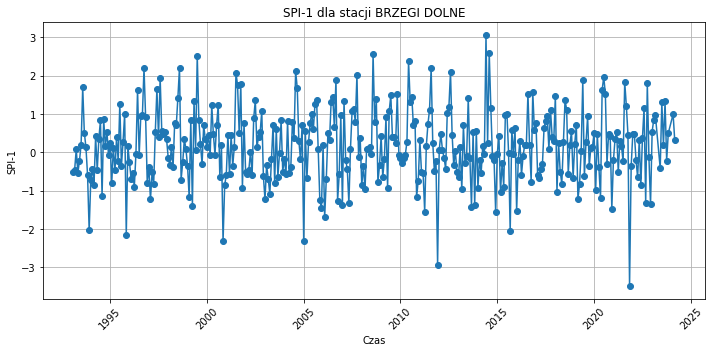

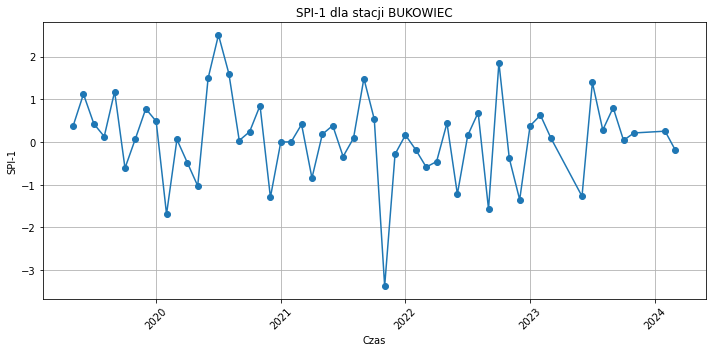

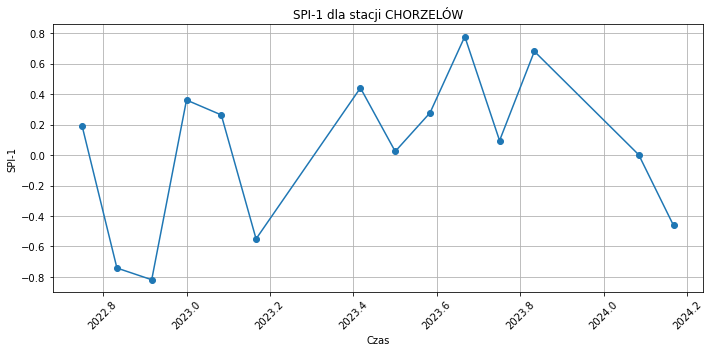

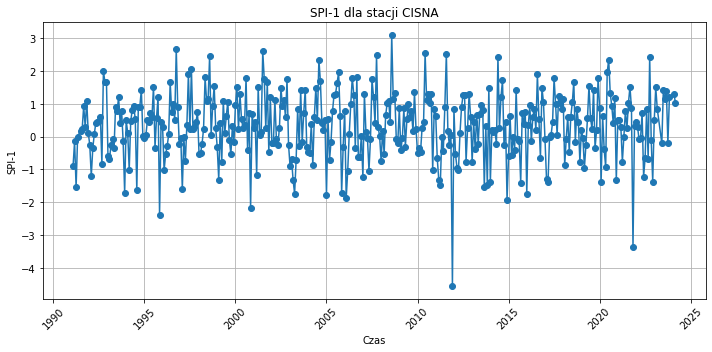

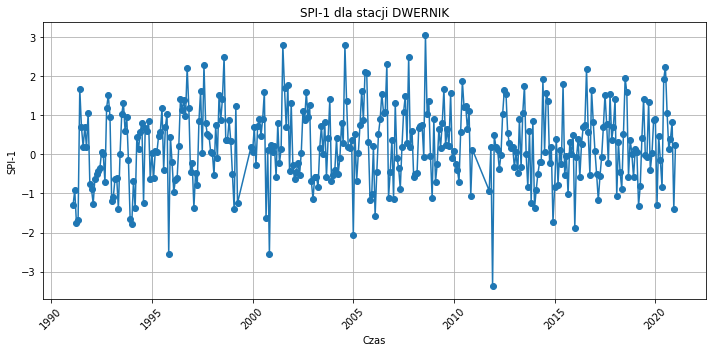

...

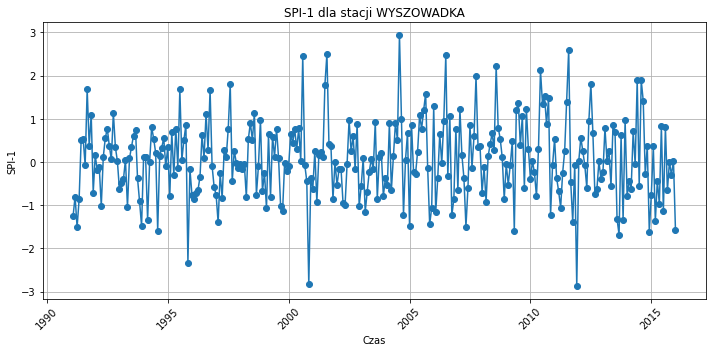

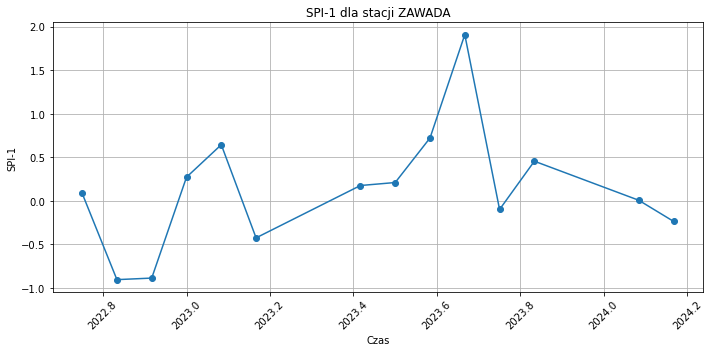

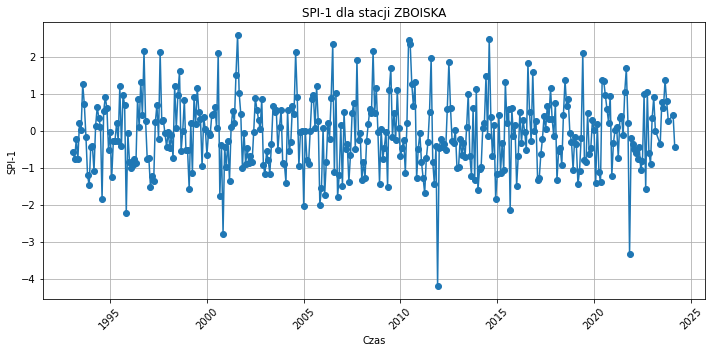

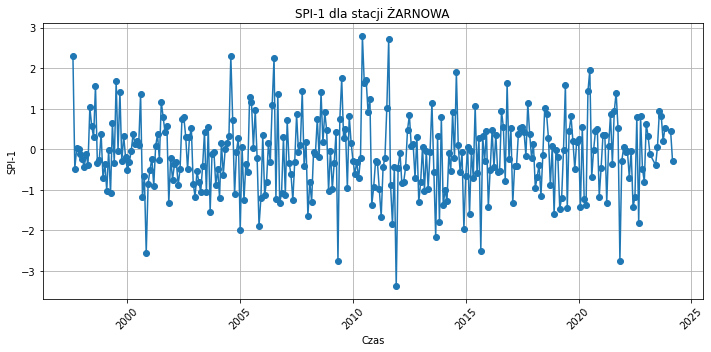

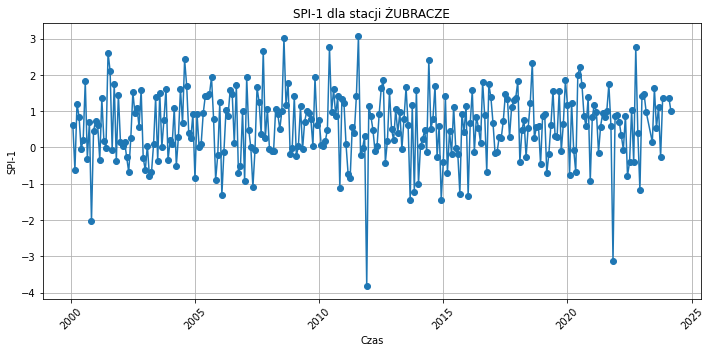

In [34]:
for station, group in joined_data.groupby('Nazwa stacji'):
    plt.figure(figsize=(10, 5))
    plt.plot(group['Rok'] + group['Miesiąc'] / 12, group['spi1'], marker='o')
    plt.title(f'SPI-1 dla stacji {station}')
    plt.xlabel('Czas')
    plt.ylabel('SPI-1')
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    filename = '../images/plot_'+station+'.png'
    plt.savefig(filename)
    plt.show()


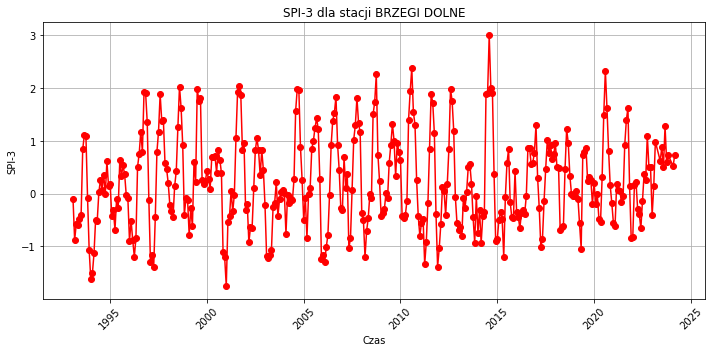

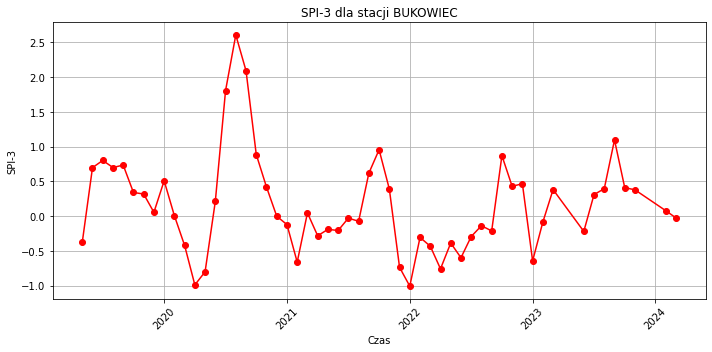

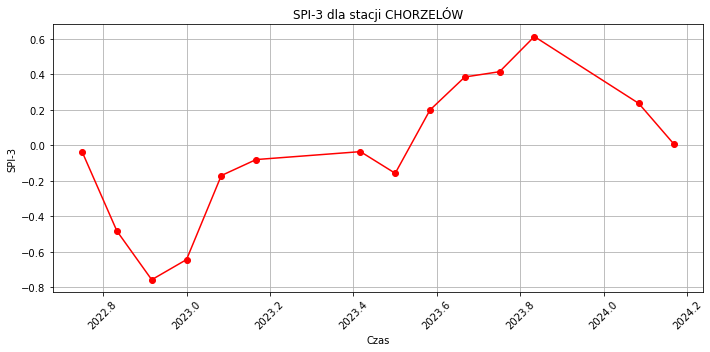

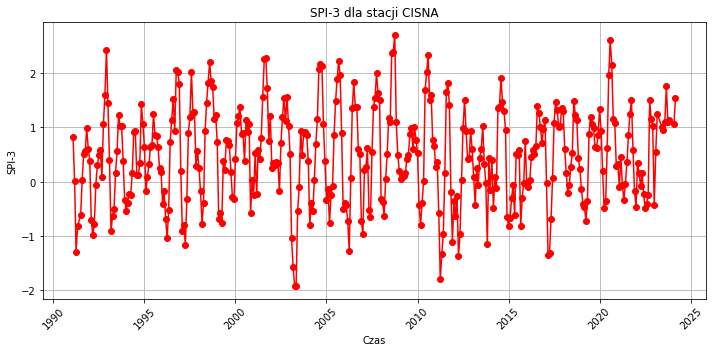

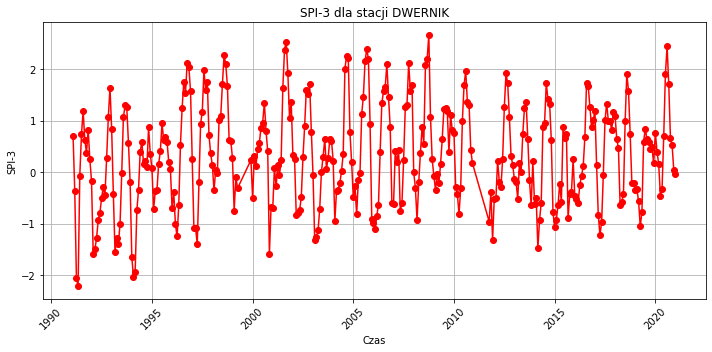

...

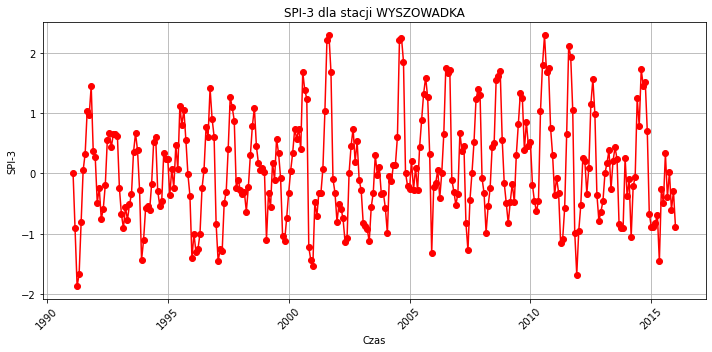

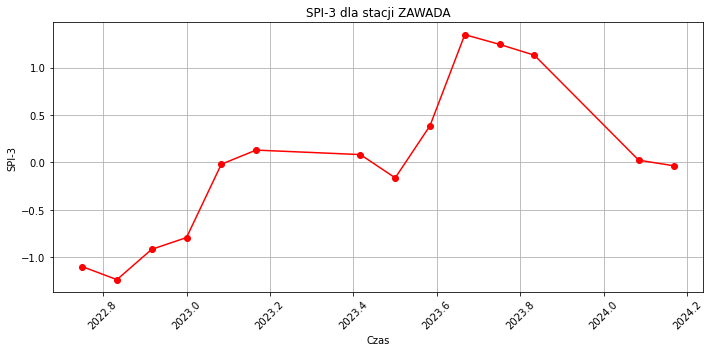

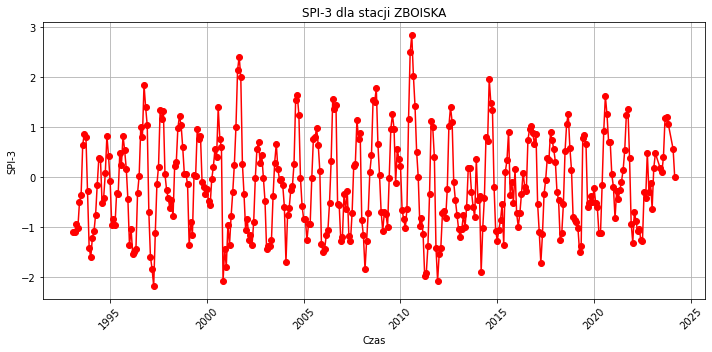

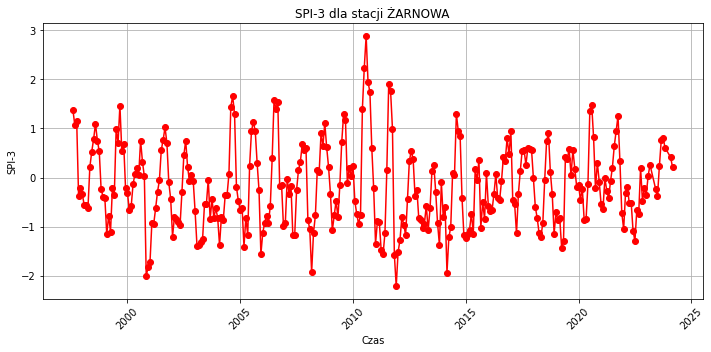

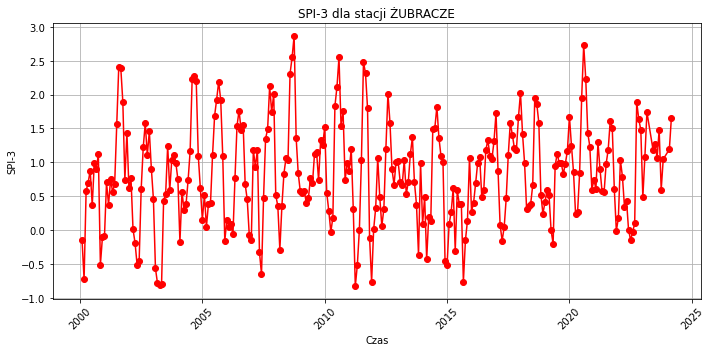

In [35]:
for station, group in joined_data.groupby('Nazwa stacji'):
    plt.figure(figsize=(10, 5))
    plt.plot(group['Rok'] + group['Miesiąc'] / 12, group['spi3'], marker='o', color = 'red')
    plt.title(f'SPI-3 dla stacji {station}')
    plt.xlabel('Czas')
    plt.ylabel('SPI-3')
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    filename = '../images/plot_spi3_'+station+'.png'
    plt.savefig(filename)
    plt.show()
    

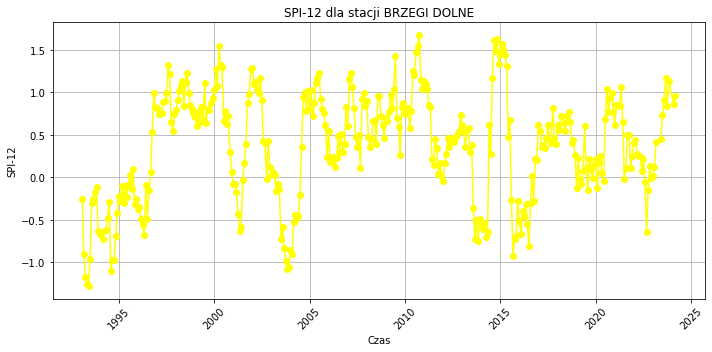

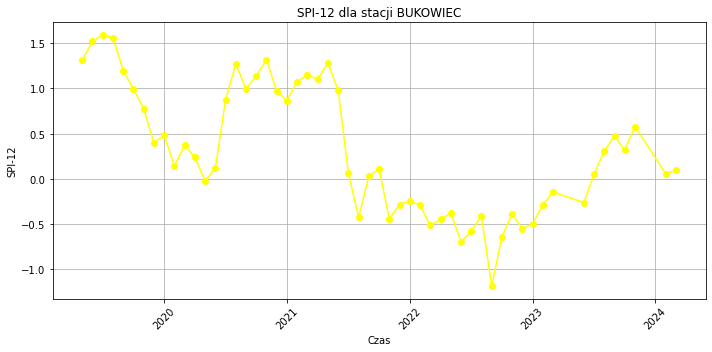

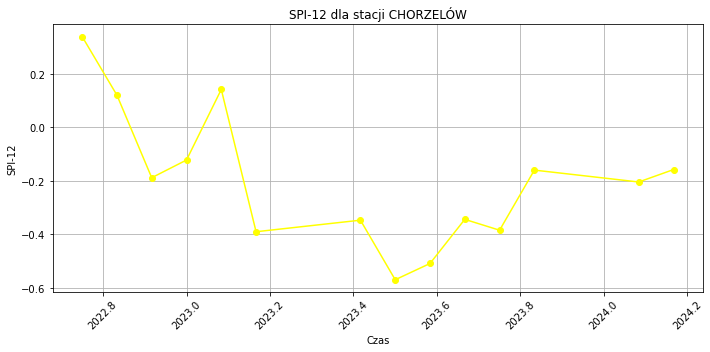

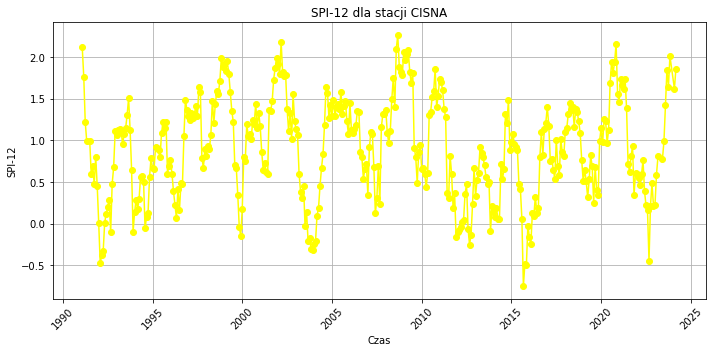

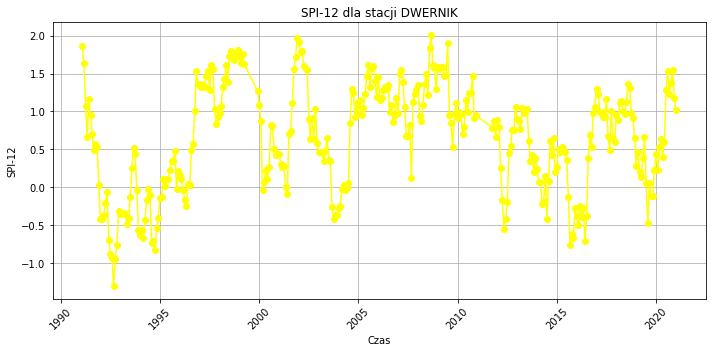

...

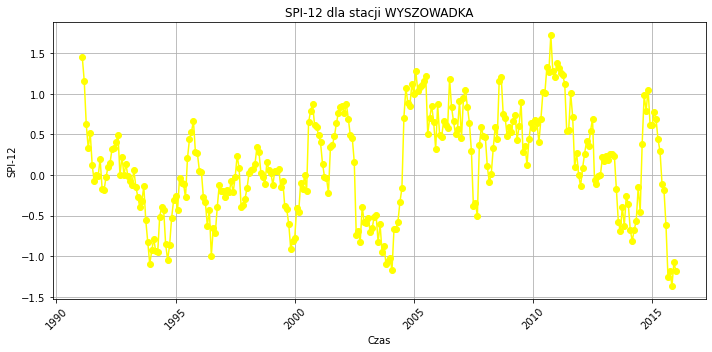

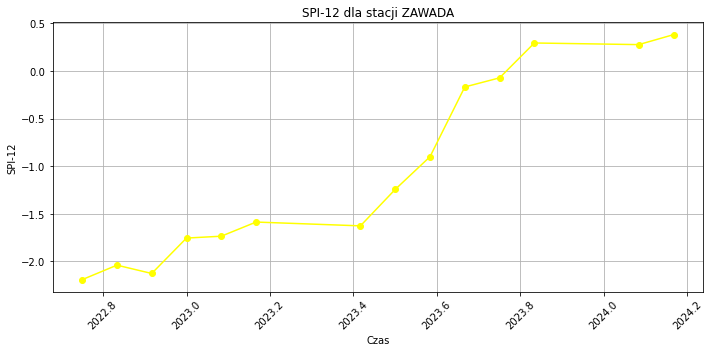

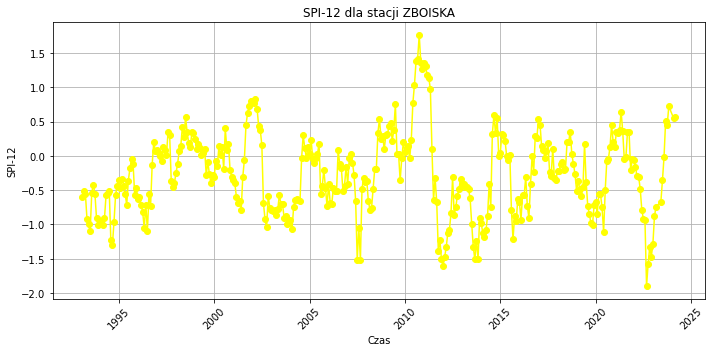

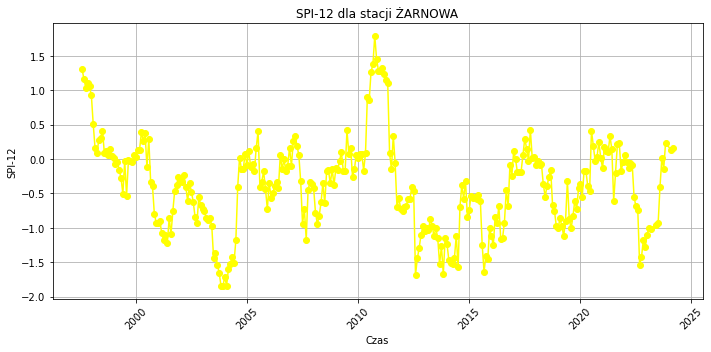

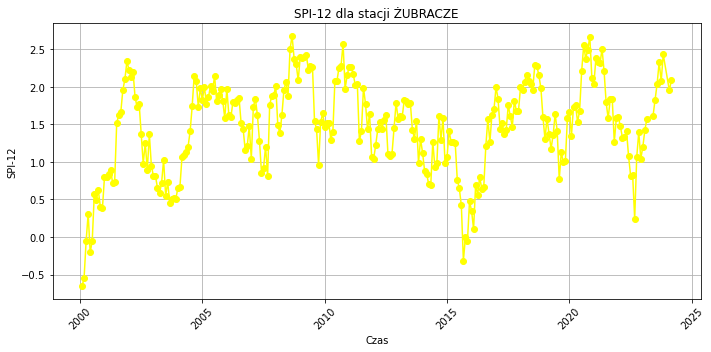

In [36]:
for station, group in joined_data.groupby('Nazwa stacji'):
    plt.figure(figsize=(10, 5))
    plt.plot(group['Rok'] + group['Miesiąc'] / 12, group['spi12'], marker='o', color = 'yellow')
    plt.title(f'SPI-12 dla stacji {station}')
    plt.xlabel('Czas')
    plt.ylabel('SPI-12')
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    filename = '../images/plot_spi12_'+station+'.png'
    plt.savefig(filename)
    plt.show()
    

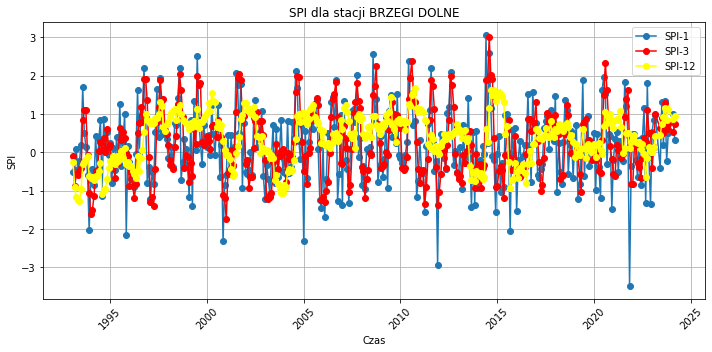

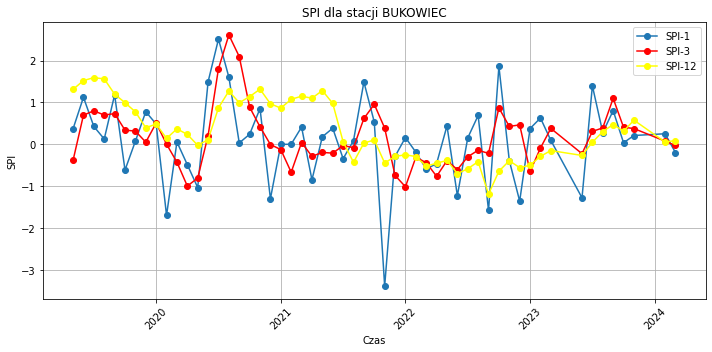

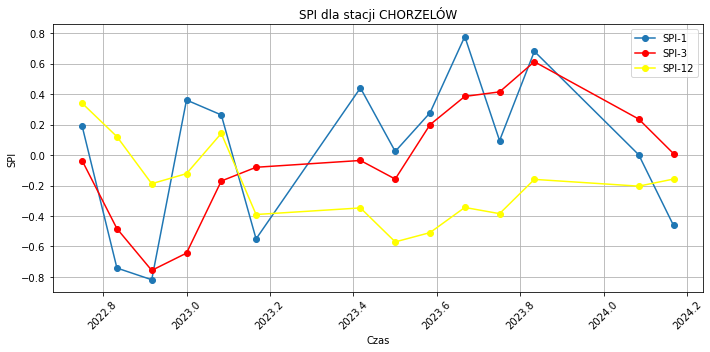

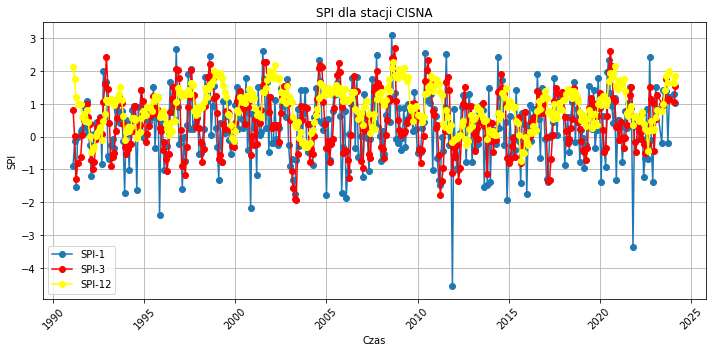

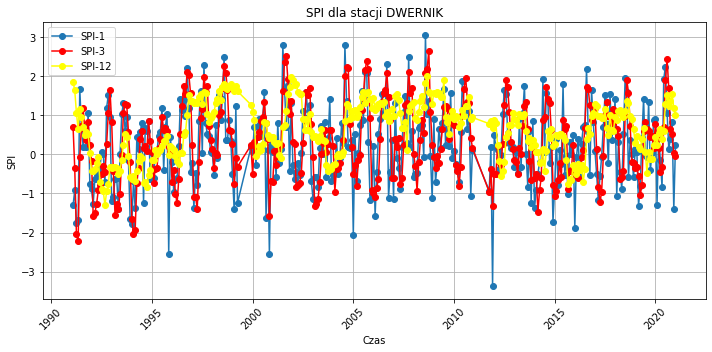

...

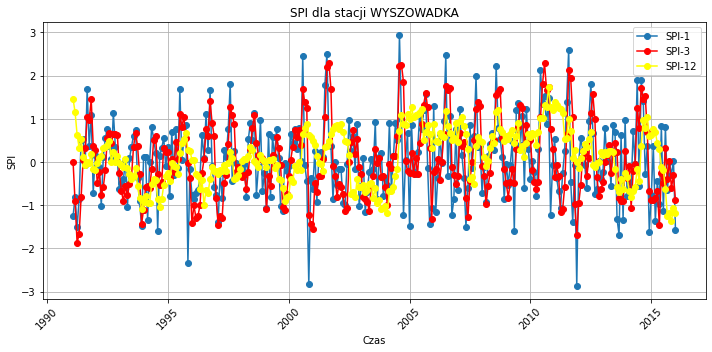

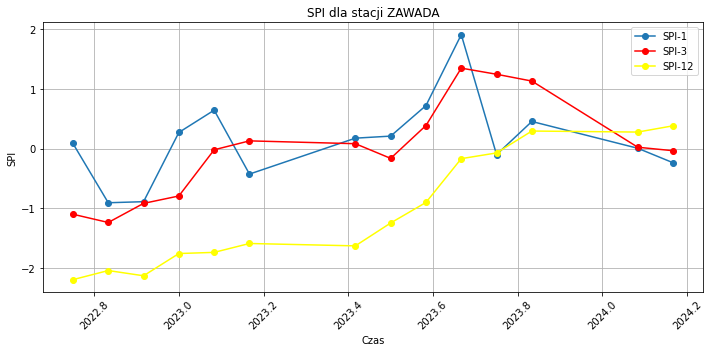

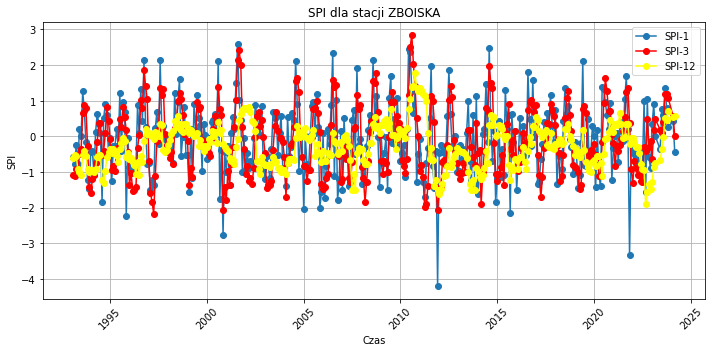

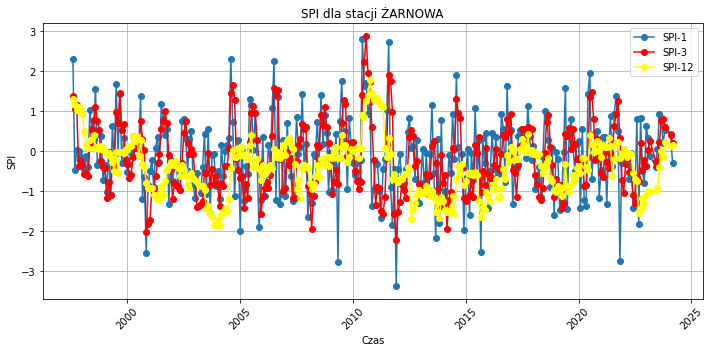

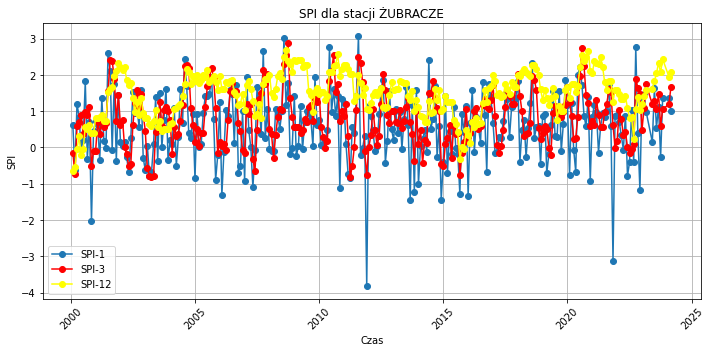

In [37]:
for station, group in joined_data.groupby('Nazwa stacji'):
    plt.figure(figsize=(10, 5))
    plt.plot(group['Rok'] + group['Miesiąc'] / 12, group['spi1'], marker='o', label = 'SPI-1')
    plt.plot(group['Rok'] + group['Miesiąc'] / 12, group['spi3'], marker='o', color = 'red', label = 'SPI-3')
    plt.plot(group['Rok'] + group['Miesiąc'] / 12, group['spi12'], marker='o', color = 'yellow', label = 'SPI-12')
    plt.title(f'SPI dla stacji {station}')
    plt.xlabel('Czas')
    plt.ylabel('SPI')
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.legend()
    filename = '../images/plot_spi_all_'+station+'.png'
    plt.savefig(filename)
    plt.show() 
    

In [16]:
# spi1_1 = spi1.set_index('date')[['spi1', 'Kod stacji']]
# spi1_1 = spi1_1.dropna()

# for station, group in spi1_1.groupby('Kod stacji'):
#     stl_result = STL(group['spi1'], period = 12).fit()
#     fig, axes = plt.subplots(2, 1, figsize=(12, 10))
#     axes[0].plot(stl_result.observed)
#     axes[0].set_title('CO2')
#     axes[1].plot(stl_result.trend)
#     axes[1].set_title('Trend')


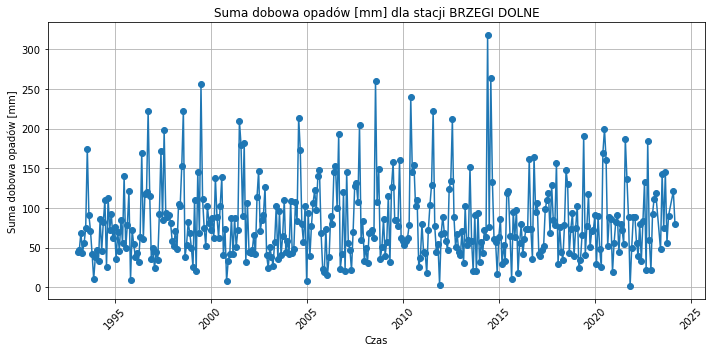

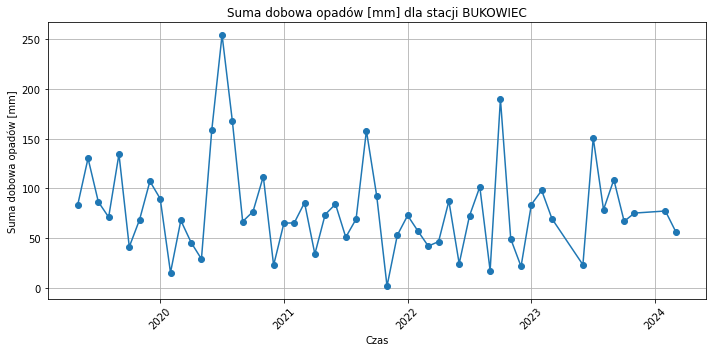

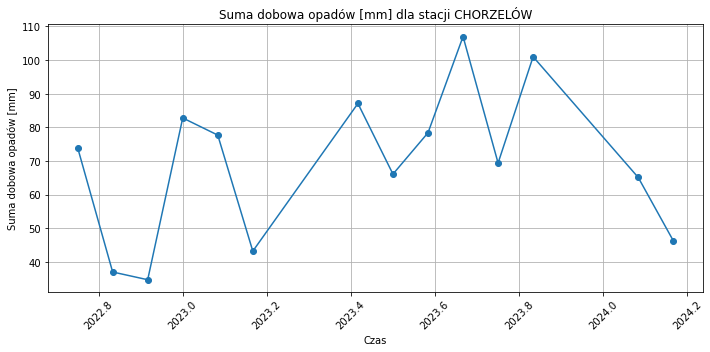

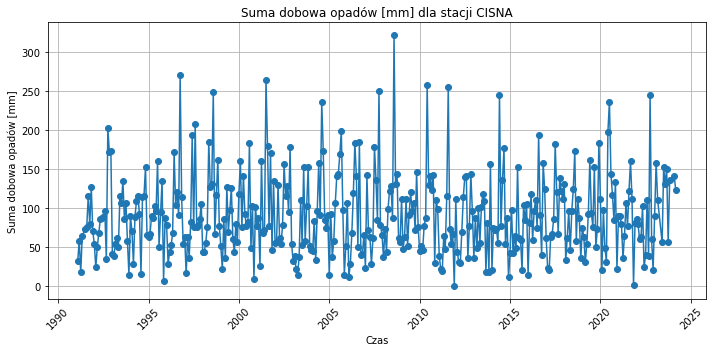

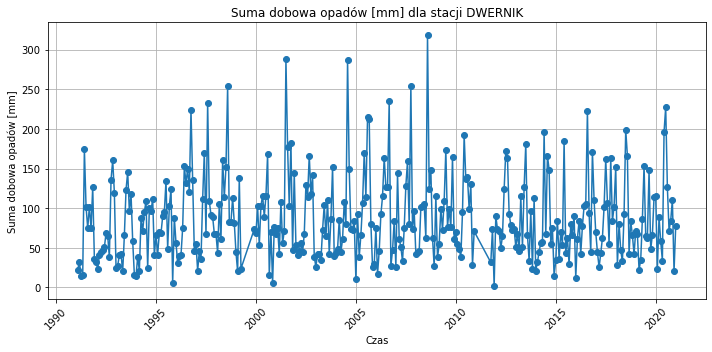

...

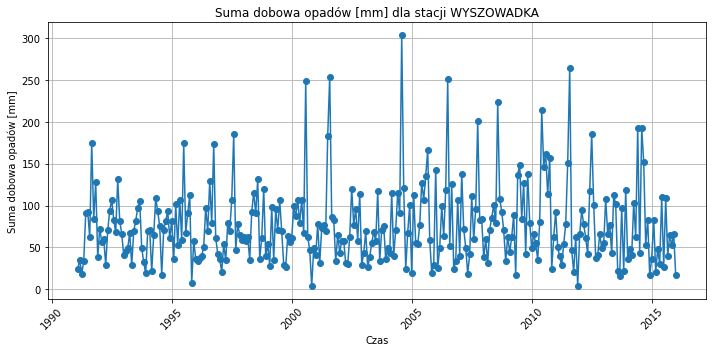

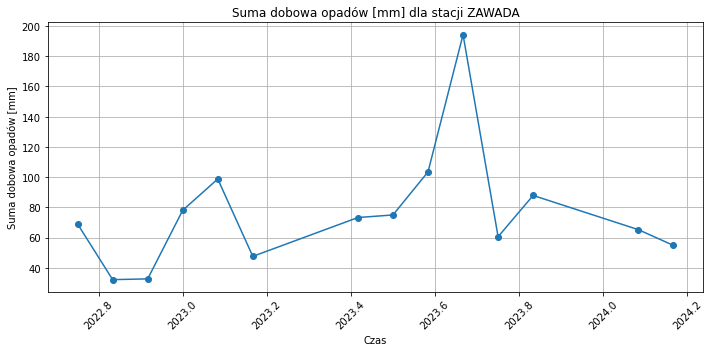

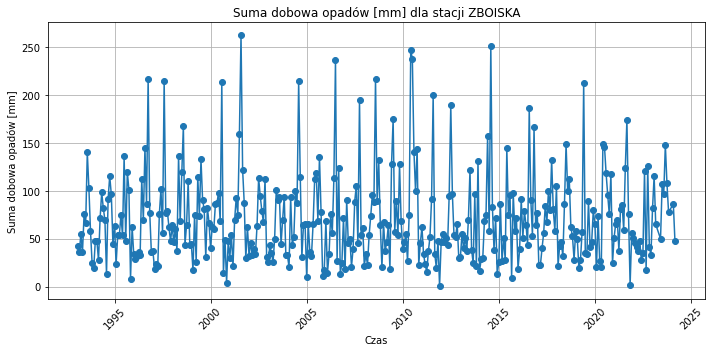

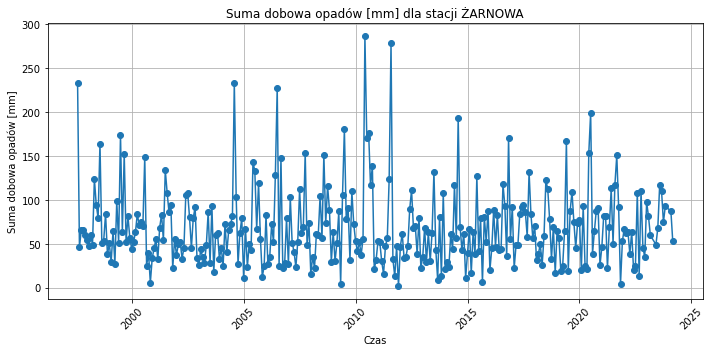

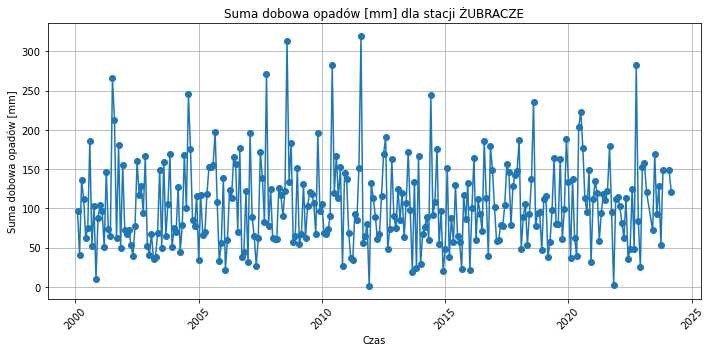

In [38]:
for station, group in joined_data.groupby('Nazwa stacji'):
    plt.figure(figsize=(10, 5))
    plt.plot(group['Rok'] + group['Miesiąc'] / 12, group['Suma dobowa opadów [mm]'], marker='o')
    plt.title(f'Suma dobowa opadów [mm] dla stacji {station}')
    plt.xlabel('Czas')
    plt.ylabel('Suma dobowa opadów [mm]')
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    filename = '../images/plot_opady_'+station+'.png'
    plt.savefig(filename)
    plt.show()  
    

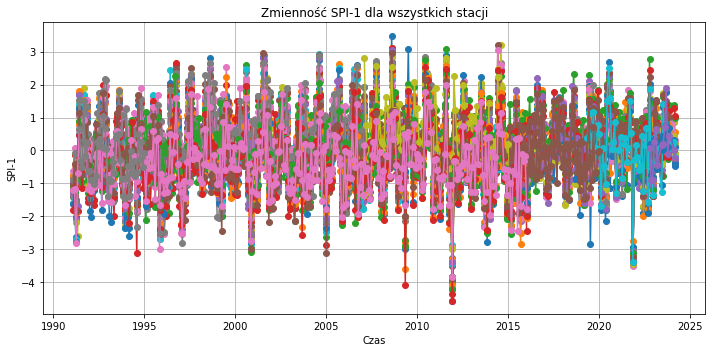

In [39]:
plt.figure(figsize=(10, 5))

for station, group in joined_data.groupby('Kod stacji'):
    plt.plot(group['Rok'] + group['Miesiąc'] / 12, group['spi1'], marker='o', label=f'Stacja {station}')


plt.title('Zmienność SPI-1 dla wszystkich stacji')
plt.xlabel('Czas')
plt.ylabel('SPI-1')
plt.grid(True)
# plt.legend()
plt.tight_layout()
filename = '../images/plot_zmiennosc_spi1.png'
plt.savefig(filename)
plt.show()


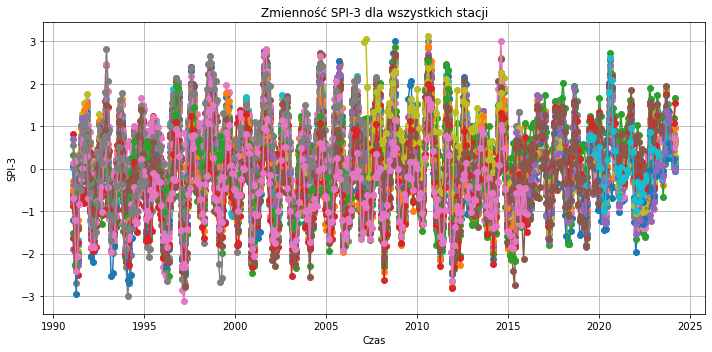

In [40]:
plt.figure(figsize=(10, 5))

for station, group in joined_data.groupby('Kod stacji'):
    plt.plot(group['Rok'] + group['Miesiąc'] / 12, group['spi3'], marker='o', label=f'Stacja {station}')


plt.title('Zmienność SPI-3 dla wszystkich stacji')
plt.xlabel('Czas')
plt.ylabel('SPI-3')
plt.grid(True)
# plt.legend()
plt.tight_layout()
filename = '../images/plot_zmiennosc_spi3.png'
plt.savefig(filename)
plt.show()


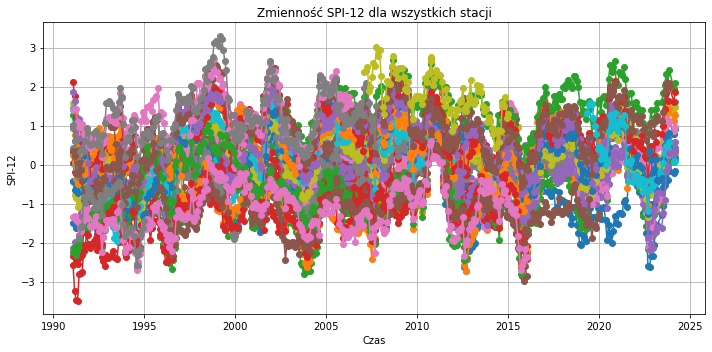

In [41]:
plt.figure(figsize=(10, 5))

for station, group in joined_data.groupby('Kod stacji'):
    plt.plot(group['Rok'] + group['Miesiąc'] / 12, group['spi12'], marker='o', label=f'Stacja {station}')


plt.title('Zmienność SPI-12 dla wszystkich stacji')
plt.xlabel('Czas')
plt.ylabel('SPI-12')
plt.grid(True)
# plt.legend()
plt.tight_layout()
filename = '../images/plot_zmiennosc_spi12.png'
plt.savefig(filename)
plt.show()


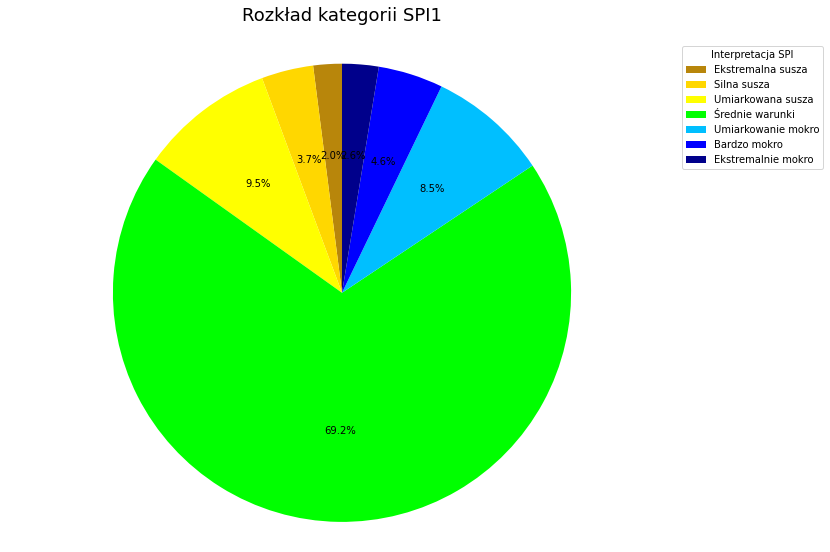

In [42]:
plt.figure(figsize=(12, 8))
bins = [spi1['spi1'].min(), -2, -1.5, -1, 1, 1.5, 2, spi1['spi1'].max()+1]
colors = ['darkgoldenrod', 'gold', 'yellow', 'lime', 'deepskyblue', 'blue', 'darkblue']

spi1['spi1_category'] = pd.cut(spi1['spi1'], bins=bins, labels=False, right=False)

category_counts = spi1['spi1_category'].value_counts().sort_index()

plt.pie(category_counts, autopct='%1.1f%%', colors=colors, startangle=90)
plt.title('Rozkład kategorii SPI1', pad=20, fontsize = 18)
plt.axis('equal')
plt.subplots_adjust(top=1) 

pm25_labels = ['Ekstremalna susza', 'Silna susza', 'Umiarkowana susza', 'Średnie warunki', 'Umiarkowanie mokro', 'Bardzo mokro', 'Ekstremalnie mokro']
plt.legend(pm25_labels, title='Interpretacja SPI', loc='upper left', bbox_to_anchor=(1, 1))
filename = '../images/spi1_kolowy.png'
plt.savefig(filename)
plt.show()




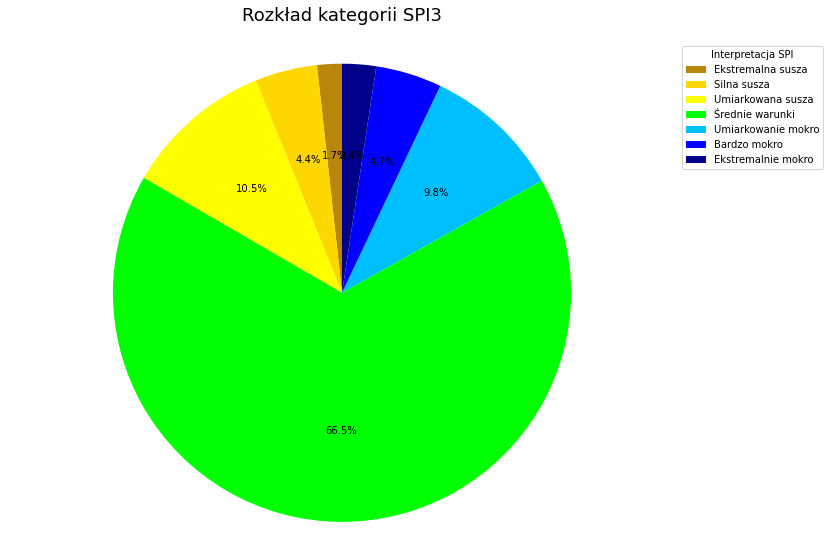

In [43]:
plt.figure(figsize=(12, 8))
bins = [spi3['spi3'].min(), -2, -1.5, -1, 1, 1.5, 2, spi3['spi3'].max()+1]
colors = ['darkgoldenrod', 'gold', 'yellow', 'lime', 'deepskyblue', 'blue', 'darkblue']

spi3['spi3_category'] = pd.cut(spi3['spi3'], bins=bins, labels=False, right=False)

category_counts = spi3['spi3_category'].value_counts().sort_index()

plt.pie(category_counts, autopct='%1.1f%%', colors=colors, startangle=90)
plt.title('Rozkład kategorii SPI3', pad=20, fontsize = 18)
plt.axis('equal')
plt.subplots_adjust(top=1) 

pm25_labels = ['Ekstremalna susza', 'Silna susza', 'Umiarkowana susza', 'Średnie warunki', 'Umiarkowanie mokro', 'Bardzo mokro', 'Ekstremalnie mokro']
plt.legend(pm25_labels, title='Interpretacja SPI', loc='upper left', bbox_to_anchor=(1, 1))
filename = '../images/spi3_kolowy.png'
plt.savefig(filename)
plt.show()



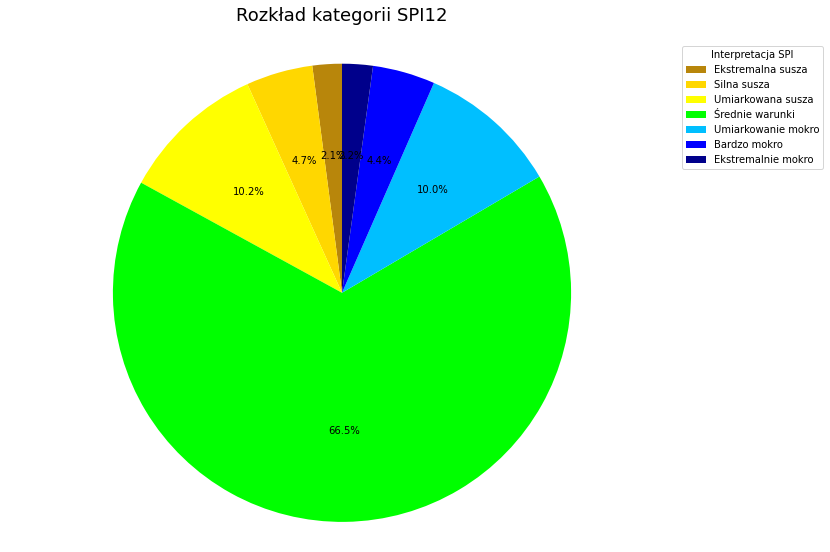

In [44]:
plt.figure(figsize=(12, 8))
bins = [spi12['spi12'].min(), -2, -1.5, -1, 1, 1.5, 2, spi12['spi12'].max()+1]
colors = ['darkgoldenrod', 'gold', 'yellow', 'lime', 'deepskyblue', 'blue', 'darkblue']

spi12['spi12_category'] = pd.cut(spi12['spi12'], bins=bins, labels=False, right=False)

category_counts = spi12['spi12_category'].value_counts().sort_index()

plt.pie(category_counts, autopct='%1.1f%%', colors=colors, startangle=90)
plt.title('Rozkład kategorii SPI12', pad=20, fontsize = 18)
plt.axis('equal')
plt.subplots_adjust(top=1) 

pm25_labels = ['Ekstremalna susza', 'Silna susza', 'Umiarkowana susza', 'Średnie warunki', 'Umiarkowanie mokro', 'Bardzo mokro', 'Ekstremalnie mokro']
plt.legend(pm25_labels, title='Interpretacja SPI', loc='upper left', bbox_to_anchor=(1, 1))
filename = '../images/spi12_kolowy.png'
plt.savefig(filename)
plt.show()



In [26]:
joined_data[['lon', 'lat']] = joined_data['geometry'].str.extract(r'POINT \(([^ ]+) ([^ ]+)\)')

joined_data['lon'] = pd.to_numeric(joined_data['lon'])
joined_data['lat'] = pd.to_numeric(joined_data['lat'])

<Figure size 720x432 with 0 Axes>

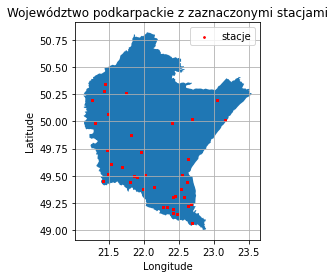

In [33]:
wojewodztwa = gpd.read_file(r"..\data_to_upload\Wojewodztwa.shp")
podkarpackie = wojewodztwa[wojewodztwa['JPT_NAZWA_'] == 'podkarpackie']

plt.figure(figsize=(10, 6))
podkarpackie.plot()
plt.scatter(joined_data['lon'], joined_data['lat'], color='red', label = 'stacje', s = 3)

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Województwo podkarpackie z zaznaczonymi stacjami')
plt.grid(True)
plt.legend()
filename = '../images/stacje_podkarpackie.png'
plt.savefig(filename)

plt.show()

In [29]:
joined_data['Animation_Frame'] = joined_data['Rok'].astype(str) + '-' + joined_data['Miesiąc'].astype(str)

In [30]:
fig = px.scatter_mapbox(joined_data, lat='lat', lon='lon', color='spi1', hover_name='spi1_Classification',
                        zoom=5, title='Weather Station Map SPI1', mapbox_style="carto-positron",
                        animation_frame='Animation_Frame',
                        range_color=(-3, 3), 
                        labels={'spi1': 'SPI1'})

fig.show()


In [31]:
fig = px.scatter_mapbox(joined_data, lat='lat', lon='lon', color='spi3', hover_name='spi3_Classification',
                        zoom=5, title='Weather Station Map SPI3', mapbox_style="carto-positron",
                        animation_frame='Animation_Frame',
                        range_color=(-3, 3), 
                        labels={'spi3': 'SPI3'})

fig.show()

In [32]:
fig = px.scatter_mapbox(joined_data, lat='lat', lon='lon', color='spi12', hover_name='spi12_Classification',
                        zoom=5, title='Weather Station Map SPI12', mapbox_style="carto-positron",
                        animation_frame='Animation_Frame',
                        range_color=(-3, 3), 
                        labels={'spi12': 'SPI12'})

fig.show()